In [27]:
from ripser import ripser
from persim import plot_diagrams
from numpy import sin,cos, dot
import numpy as np
from numpy import pi,cos,sin
import matplotlib.pyplot as plt
import random
from math import dist

In [228]:
def F(x,y):
    ret = 0
    if 0<= x % 1 < 0.1:
        ret = 1
    if 0.4 < y % 1 < 0.6 and 0 < x % 1 < 0.5:
        ret = 1
    if y % 1 > 0.8 and 0 < x % 1 < 0.5:
        ret = 1
    return ret

In [229]:
 def graph_continuous(image_function, x, y, x_random = True, n_samples= 100000, y_random = True):
    
    if x_random == True:
        X = list(2 * x * np.random.random(n_samples) - x) 
        if y_random == True:
            Y = list(2 * y * np.random.random(n_samples) - y) 
        else:
            Y = np.linspace(-y,y,n_samples)      

    if x_random == False:
        X = np.linspace(-x,x,n_samples)
        if y_random == True:
            Y = list(2 * y * np.random.random(n_samples) - y) 
        else:
            Y = np.linspace(-y,y,n_samples)   

    x_points = []
    y_points = []
    colors = []
    for i in range(n_samples):
        color = image_function(X[i],Y[i]) 
        colors.append(color)
        x_points.append(X[i])
        y_points.append(Y[i])

        
    fig = plt.figure(figsize = (4, 4))
    ax = plt.axes()
    ax.scatter(x_points, y_points, c = colors, s = .1)
    plt.show()
    
    
def view_window_continuous(image_function, num_pixels, window_size):
    
    pixels = get_pixels(num_pixels, window_size)
            
    x_points = []
    y_points = []
    colors = []
    for i in range(len(pixels)):
        color = image_function(pixels[i][0],pixels[i][1]) 
        colors.append(color)
        x_points.append(pixels[i][0])
        y_points.append(pixels[i][1])
    
    fig = plt.figure(figsize = (4, 4))
    ax = plt.axes()
    ax.scatter(x_points, y_points, c = colors)
    plt.show()
    
def view_isom(a, b, theta , image_function, num_pixels, window_size):
    
    pixels = get_pixels(num_pixels, window_size)
    
    iso_inv = isom(-1 * a,-1 * b,2 * pi - theta)
    
    pixels_inv = []
    for pixel in pixels: 
        pixels_inv.append(iso_inv(pixel[0], pixel[1]))
    
    x_points = []
    y_points = []
    colors = []
    for i in range(len(pixels_inv)):
        color = image_function(pixels_inv[i][0],pixels_inv[i][1]) 
        colors.append(color)
        x_points.append(pixels[i][0])
        y_points.append(pixels[i][1])  

    fig = plt.figure(figsize = (4, 4))
    ax = plt.axes()
    ax.scatter(x_points, y_points, c = colors)
    plt.show()

    
def get_pixels(num_pixels, window_size):
    sample = list(np.linspace(-window_size/2, window_size/2, num_pixels))
    pixels = []
    for i in range(len(sample)):
        for j in range(len(sample)):
            pixels.append((sample[i],sample[j]))     
    return pixels


def get_colors(pixels, image_function):
    colors = []
    for pixel in pixels:
        colors.append(image_function(pixel[0],pixel[1]))
    return colors  

def translation(a,b):
    def t_ab(x,y): 
        return x+a, y+b
    return t_ab

def rotation(theta):
    def r_theta(x,y):
        return x * cos(theta) - y * sin(theta), x * sin(theta) + y * cos(theta)
    return r_theta

def isom(a,b,theta):
    def iso(x,y):
        r = rotation(theta)
        t = translation(a,b)
        return t(r(x,y)[0], r(x,y)[1])
    return iso

def generate_isom(n_isos, x_translate, y_translate):
    a = list(2 * x_translate * np.random.random(n_isos) - x_translate) # sampling from (-x,x)
    b = list(2 * y_translate * np.random.random(n_isos) - y_translate) # sampling from (-y,y)
    theta = list(2 * pi * np.random.random(n_isos)) # sampling from (0, 2pi)

    isos = []
    isos_inv = []
    for i in range(n_isos):
        isos.append(isom(a[i], b[i], theta[i]))
        isos_inv.append(isom(-1 * a[i],-1 * b[i],2 * pi - theta[i])) 
    return isos_inv

def new_colors(pixels, iso_inv, image_function):
    pixels_inv = []
    for pixel in pixels: 
        pixels_inv.append(iso_inv(pixel[0], pixel[1]))
    new_colors = get_colors(pixels_inv, image_function)
    return new_colors

def matrix_of_images(pixels, isos_inv, image_function):
    vectors = []
    for i in isos_inv:
        vectors.append([new_colors(pixels, i, image_function)])
    M = np.concatenate(vectors, axis=0 )
    return M

def p_hom(M, maxdim, coeff):
    output = ripser(M, maxdim = maxdim, coeff = coeff)
    return output
    
def persistent_H1_intervals(output):
    H1 = output['dgms'][1].tolist() # all intervals in H1
    d = []
    for pair in H1: 
        d.append(pair[1] - pair[0]) # finding lengths of intervals in H1
    d.sort(reverse = True) # sorting from longest to shortest intervals
    d
    return d

def plot_dgms(output):
    dgms = output['dgms']
    fig = plt.figure(figsize = (12, 6))
    plot_diagrams(dgms)
    
def pipeline(image_function, num_pixels, window_size, n_isos, x_translate, y_translate, maxdim, coeff):
    pixels = get_pixels(num_pixels, window_size)
    isos_inv = generate_isom(n_isos, x_translate, y_translate)
    M = matrix_of_images(pixels, isos_inv, image_function)
    output = p_hom(M, maxdim, coeff)
    return output

def generate_90_isom(n_isos, x_translate, y_translate):
    a = list(2 * x_translate * np.random.random(n_isos) - x_translate) # sampling from (-x,x)
    b = list(2 * y_translate * np.random.random(n_isos) - y_translate) # sampling from (-y,y)
    theta = list(pi/2 * np.ones(n_isos)) 

    isos = []
    isos_inv = []
    for i in range(n_isos):
        isos.append(isom(a[i], b[i], theta[i]))
        isos_inv.append(isom(-1 * a[i],-1 * b[i],2 * pi - theta[i])) 
    return isos_inv

def generate_180_isom(n_isos, x_translate, y_translate):
    a = list(2 * x_translate * np.random.random(n_isos) - x_translate) # sampling from (-x,x)
    b = list(2 * y_translate * np.random.random(n_isos) - y_translate) # sampling from (-y,y)
    theta = list(pi * np.ones(n_isos)) 

    isos = []
    isos_inv = []
    for i in range(n_isos):
        isos.append(isom(a[i], b[i], theta[i]))
        isos_inv.append(isom(-1 * a[i],-1 * b[i],2 * pi - theta[i])) 
    return isos_inv


def view_isom2(isom_inv, image_function, num_pixels, window_size):
    
    pixels = get_unitsq_pixels(num_pixels, window_size)
    
    pixels_inv = []
    for pixel in pixels: 
        pixels_inv.append(isom_inv(pixel[0], pixel[1]))
    
    x_points = []
    y_points = []
    colors = []
    for i in range(len(pixels_inv)):
        color = image_function(pixels_inv[i][0],pixels_inv[i][1]) 
        colors.append(color)
        x_points.append(pixels[i][0])
        y_points.append(pixels[i][1])  

    fig = plt.figure(figsize = (4, 4))
    ax = plt.axes()
    ax.scatter(x_points, y_points, c = colors)
    plt.show()
    
    
def get_unitsq_pixels(num_pixels, window_size):
    sample = list(np.linspace(0, window_size, num_pixels))
    pixels = []
    for i in range(len(sample)):
        for j in range(len(sample)):
            pixels.append((sample[i],sample[j]))     
    return pixels

    
    
def view_window_continuous_unitsq(image_function, num_pixels, window_size):
    
    pixels = get_unitsq_pixels(num_pixels, window_size)
            
    x_points = []
    y_points = []
    colors = []
    for i in range(len(pixels)):
        color = image_function(pixels[i][0],pixels[i][1]) 
        colors.append(color)
        x_points.append(pixels[i][0])
        y_points.append(pixels[i][1])
    
    fig = plt.figure(figsize = (4, 4))
    ax = plt.axes()
    ax.scatter(x_points, y_points, c = colors)
    plt.show()
    
    
def pipeline_unitsq(image_function, num_pixels, window_size, n_isos, x_translate, y_translate, maxdim, coeff):
    pixels = get_unitsq_pixels(num_pixels, window_size)
    isos_inv = generate_isom(n_isos, x_translate, y_translate)
    M = matrix_of_images(pixels, isos_inv, image_function)
    output = p_hom(M, maxdim, coeff)
    return output

# starting with C1

In [230]:
isoms = []
for i in range(20):
    a = i/19
    f = isom(a,0,0)
    isoms.append(f)

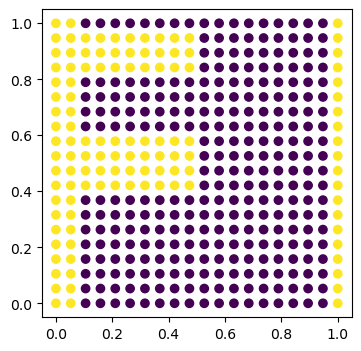

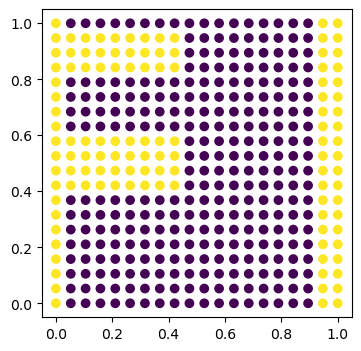

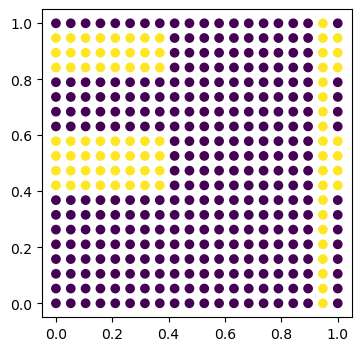

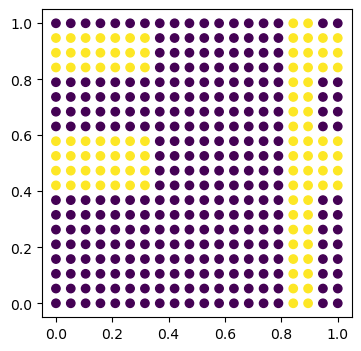

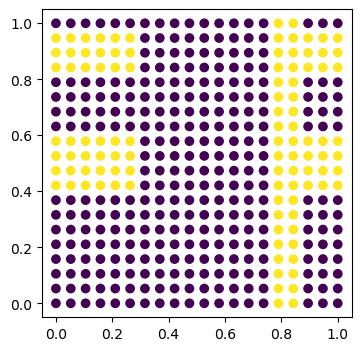

...

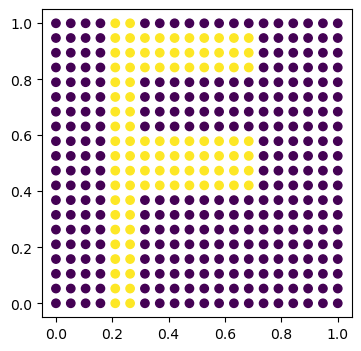

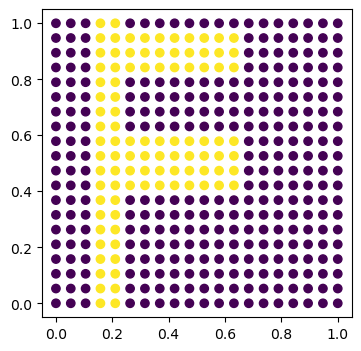

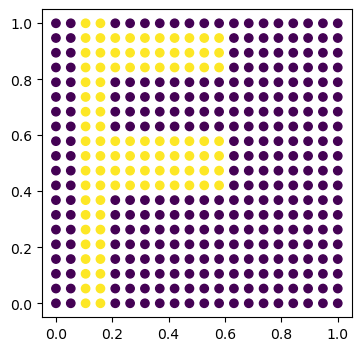

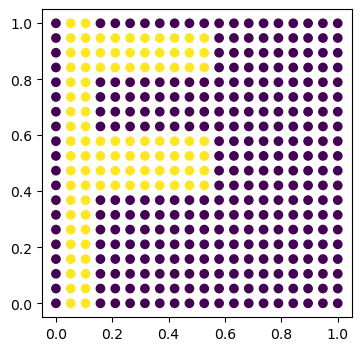

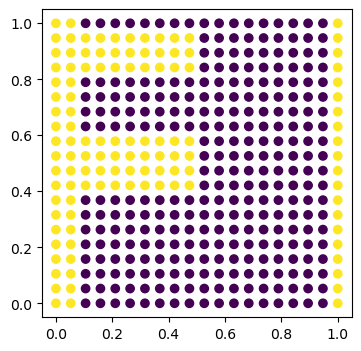

In [231]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function =F, num_pixels = 20, window_size =1)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=1)
    point = new_colors(pixels, iso_inv=f, image_function=F)
    points_in_R400.append(point)

In [40]:
points_in_R400

[[1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  1,
  0,
  0,
  0,
  0,
  1,
  1,
  1,
  0,


In [232]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[6.324555320336759,
 5.744562646538029,
 7.745966692414834,
 6.324555320336759,
 6.324555320336759,
 4.47213595499958,
 7.745966692414834,
 6.324555320336759,
 6.324555320336759,
 6.855654600401044,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 7.745966692414834,
 0.0]

In [233]:
sum(distances)

122.529472443561

In [234]:
isoms = []
for i in range(20):
    b = i/19
    f = isom(0,b,0)
    isoms.append(f)

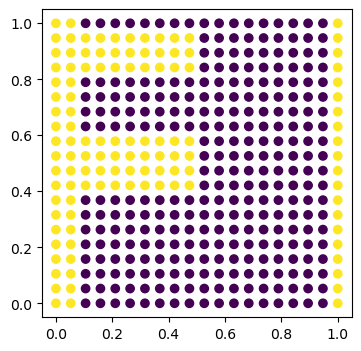

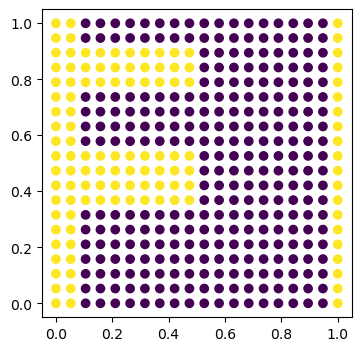

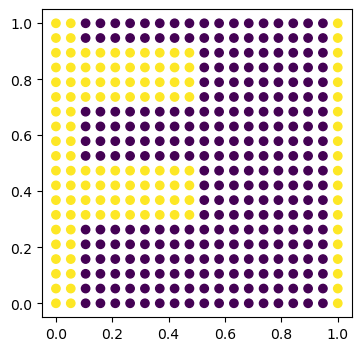

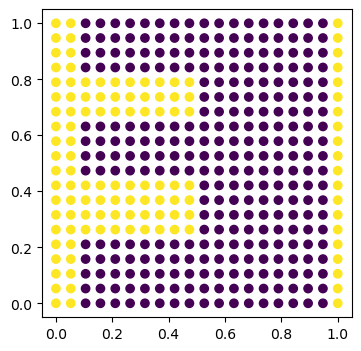

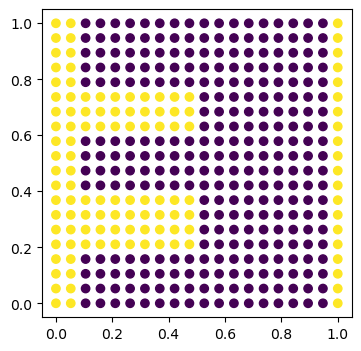

...

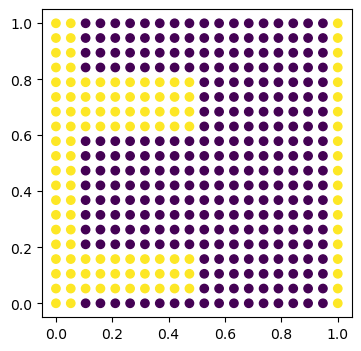

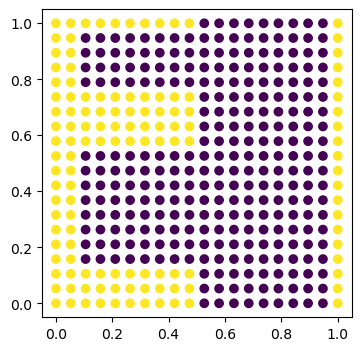

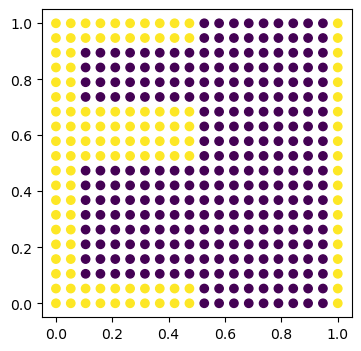

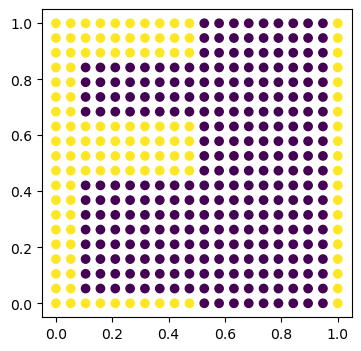

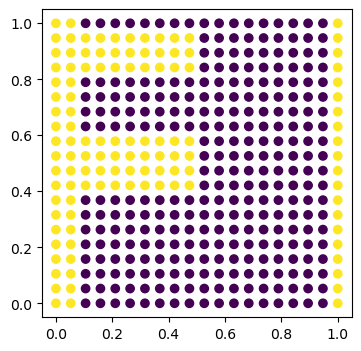

In [235]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function =F, num_pixels = 20, window_size =1)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=1)
    point = new_colors(pixels, iso_inv=f, image_function=F)
    points_in_R400.append(point)

In [236]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[5.656854249492381,
 4.898979485566356,
 6.324555320336759,
 5.656854249492381,
 5.656854249492381,
 4.898979485566356,
 6.324555320336759,
 6.324555320336759,
 5.656854249492381,
 5.656854249492381,
 5.656854249492381,
 6.324555320336759,
 5.656854249492381,
 5.656854249492381,
 5.656854249492381,
 6.324555320336759,
 5.656854249492381,
 5.656854249492381,
 6.324555320336759,
 0.0]

In [237]:
sum(distances)

109.97068763756947

In [238]:
isoms = []
for i in range(20):
    theta = 2 * pi/19 * i 
    f = isom(0,0,theta)
    isoms.append(f)

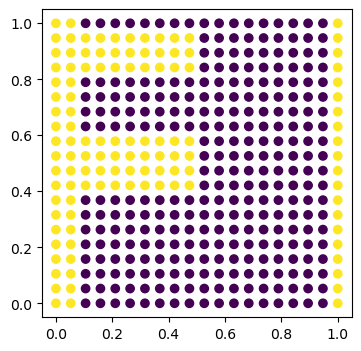

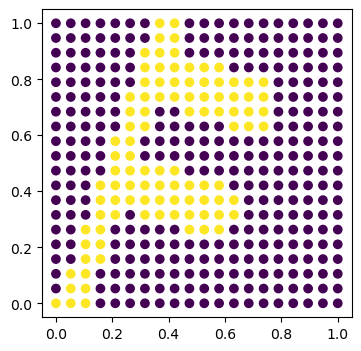

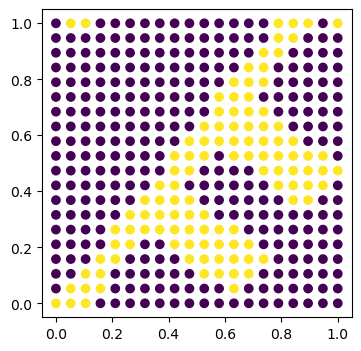

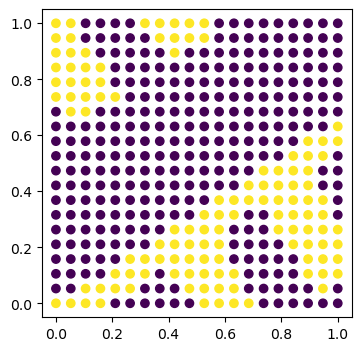

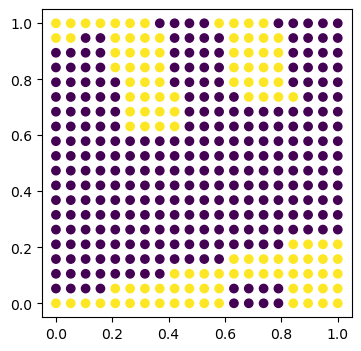

...

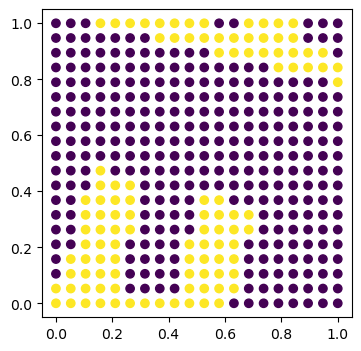

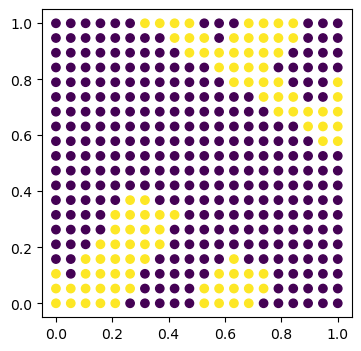

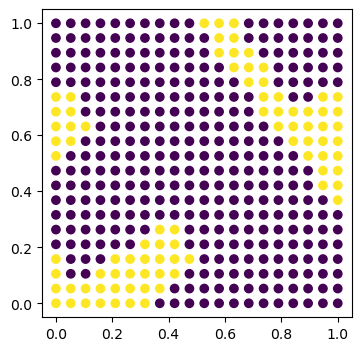

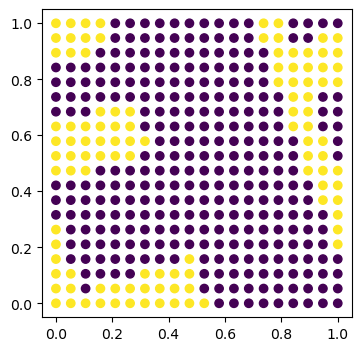

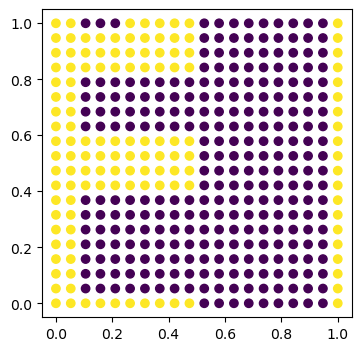

In [239]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function =F, num_pixels = 20, window_size =1)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=1)
    point = new_colors(pixels, iso_inv=f, image_function=F)
    points_in_R400.append(point)

In [240]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[12.489995996796797,
 11.74734012447073,
 12.68857754044952,
 12.84523257866513,
 13.30413469565007,
 12.36931687685298,
 12.409673645990857,
 12.569805089976535,
 12.041594578792296,
 12.68857754044952,
 12.68857754044952,
 12.083045973594572,
 11.74734012447073,
 11.445523142259598,
 11.40175425099138,
 9.848857801796104,
 9.746794344808963,
 10.63014581273465,
 11.313708498984761,
 3.605551275463989]

In [241]:
sum(distances)

229.66554743364873

In [250]:
def compose_isoms(i1,i2, i3):
    def comp(x,y):
        x2 = i1(x,y)[0]
        y2 = i1(x,y)[1]
        x3 = i2(x2,y2)[0]
        y3 = i2(x2,y2)[1]
        return i3(x3,y3)
    return comp

In [251]:
isoms = []
for i in range(20):
    theta = 2 * pi/19 * i 
    isom1 = isom(-.5,-.5,0)
    isom2 = isom(0,0,theta)
    isom3 = isom(.5,.5,0)
    f = compose_isoms(isom1,isom2,isom3)
    isoms.append(f)

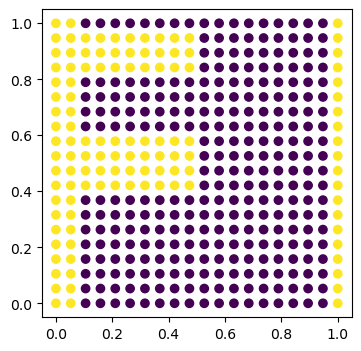

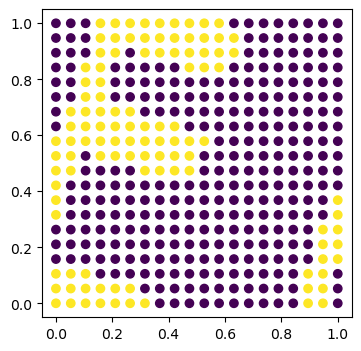

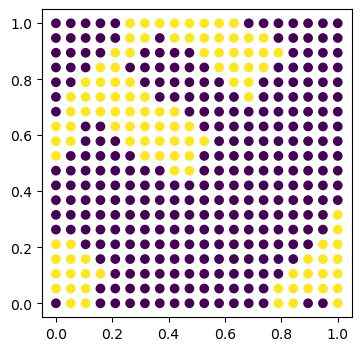

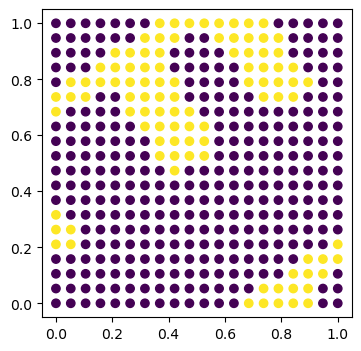

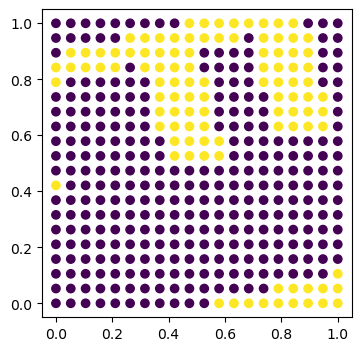

...

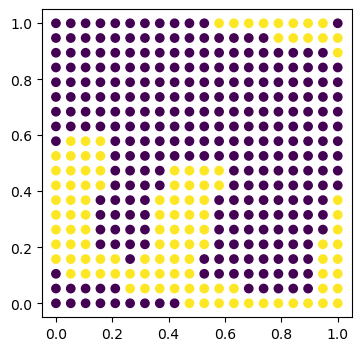

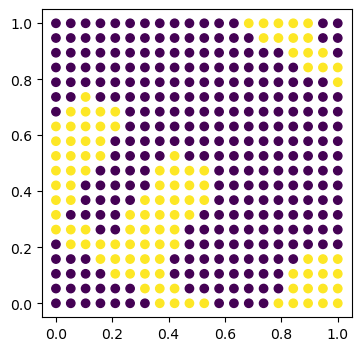

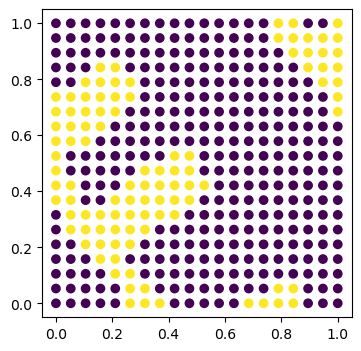

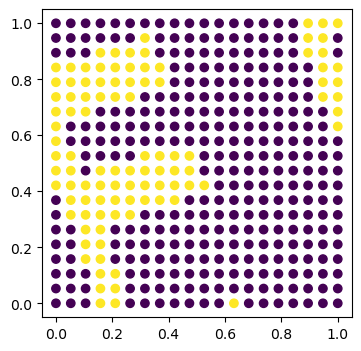

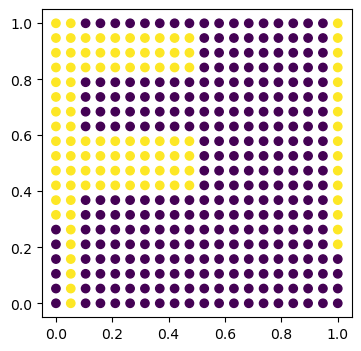

In [252]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function =F, num_pixels = 20, window_size =1)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=1)
    point = new_colors(pixels, iso_inv=f, image_function=F)
    points_in_R400.append(point)

In [253]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[10.535653752852738,
 9.0,
 9.1104335791443,
 9.273618495495704,
 10.583005244258363,
 9.1104335791443,
 9.327379053088816,
 9.1104335791443,
 9.539392014169456,
 10.246950765959598,
 9.327379053088816,
 9.16515138991168,
 9.219544457292887,
 9.38083151964686,
 10.535653752852738,
 9.1104335791443,
 9.055385138137417,
 8.774964387392123,
 9.848857801796104,
 3.1622776601683795]

In [254]:
sum(distances)

183.41777880268884

horizontal: 123

vertical: 110

rotational: 183

# trying with C2

In [255]:
def sincos(x,y):
    return sin(2 * x + y) * cos(y)

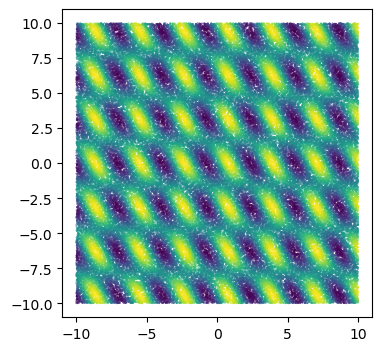

In [256]:
graph_continuous(sincos, 10, 10, x_random = True, n_samples= 100000, y_random = True)

In [281]:
def get_sq_pixels(num_pixels, window_size, x_center):
    sample_x = list(np.linspace(x_center, window_size, num_pixels))
    sample_y = list(np.linspace(0, window_size, num_pixels))
    pixels = []
    for i in range(len(sample_x)):
        for j in range(len(sample_y)):
            pixels.append((sample_x[i],sample_y[j]))     
    return pixels

def view_window_continuous_sq(image_function, num_pixels, window_size, x_center):
    
    pixels = get_sq_pixels(num_pixels, window_size,x_center)
            
    x_points = []
    y_points = []
    colors = []
    for i in range(len(pixels)):
        color = image_function(pixels[i][0],pixels[i][1]) 
        colors.append(color)
        x_points.append(pixels[i][0])
        y_points.append(pixels[i][1])
    
    fig = plt.figure(figsize = (4, 4))
    ax = plt.axes()
    ax.scatter(x_points, y_points, c = colors)
    plt.show()
    
def view_isom_sq(isom_inv, image_function, num_pixels, window_size,x_center):
    
    pixels = get_sq_pixels(num_pixels, window_size, x_center)
    
    pixels_inv = []
    for pixel in pixels: 
        pixels_inv.append(isom_inv(pixel[0], pixel[1]))
    
    x_points = []
    y_points = []
    colors = []
    for i in range(len(pixels_inv)):
        color = image_function(pixels_inv[i][0],pixels_inv[i][1]) 
        colors.append(color)
        x_points.append(pixels[i][0])
        y_points.append(pixels[i][1])  

    fig = plt.figure(figsize = (4, 4))
    ax = plt.axes()
    ax.scatter(x_points, y_points, c = colors)
    plt.show()

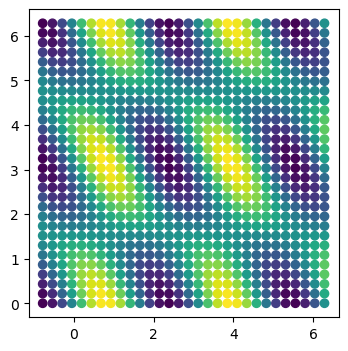

In [283]:
view_window_continuous_sq(image_function=sincos, num_pixels=30, window_size=2*pi, x_center = -pi/4)

In [299]:
isoms = []
for i in range(20):
    a = i * pi/19
    f = isom(a,0,0)
    isoms.append(f)

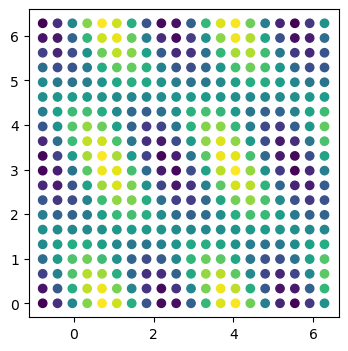

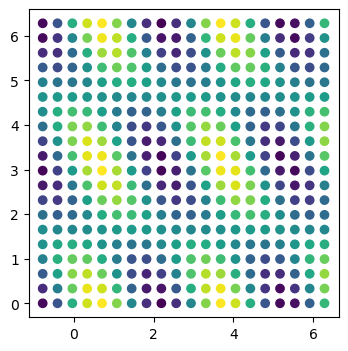

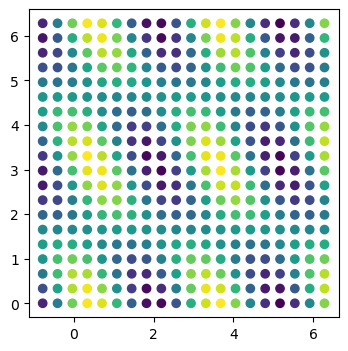

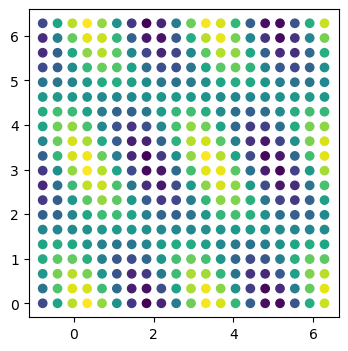

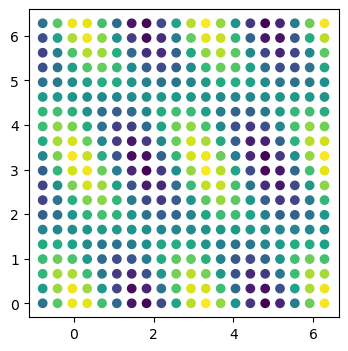

...

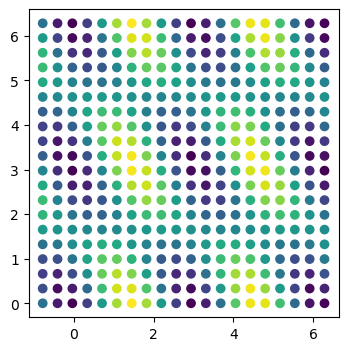

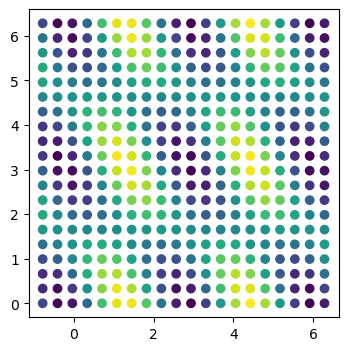

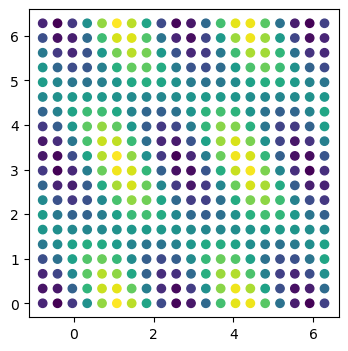

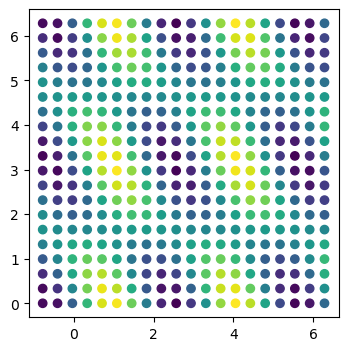

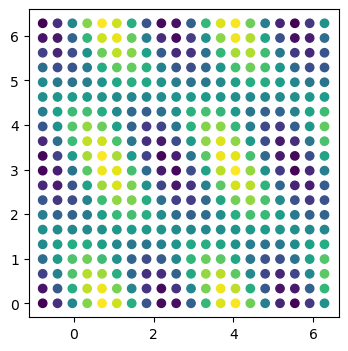

In [300]:
points_in_R400 = []
for f in isoms:
    view_isom_sq(isom_inv = f,image_function =sincos, num_pixels = 20, window_size =2*pi, x_center = -pi/4)
    pixels = get_sq_pixels(num_pixels = 20, window_size=2*pi, x_center = -pi/4)
    point = new_colors(pixels, iso_inv=f, image_function=sincos)
    points_in_R400.append(point)

In [301]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[3.3894348687729603,
 3.4149238967823665,
 3.4228143053935116,
 3.409893482366669,
 3.3814321999355115,
 3.3492241262604776,
 3.3269280123399607,
 3.3241992713292676,
 3.3422310662634622,
 3.3731853258999505,
 3.4038581030114567,
 3.4214701065810136,
 3.4188168255174296,
 3.3969775150577854,
 3.364918240161669,
 3.3360732792681205,
 3.322815179411429,
 3.3309237855162874,
 3.35685712476409,
 1.024061567525607e-14]

In [302]:
sum(distances)

64.08697671463344

In [348]:
isoms = []
for i in range(20):
    b = i * pi/19
    f = isom(0,b,0)
    isoms.append(f)

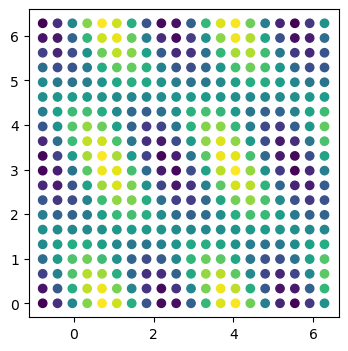

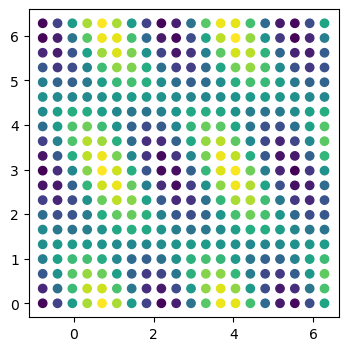

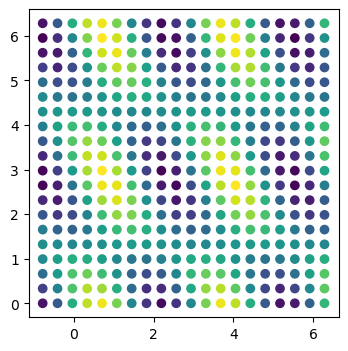

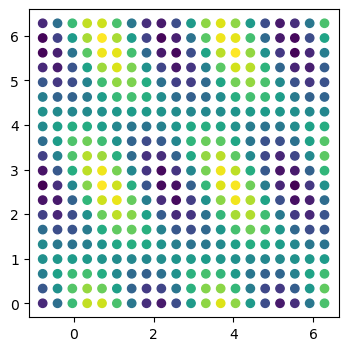

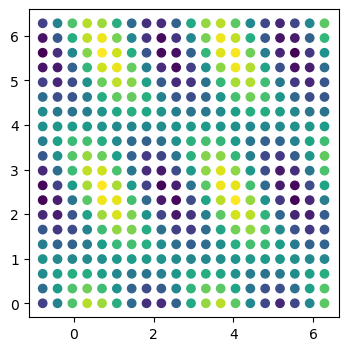

...

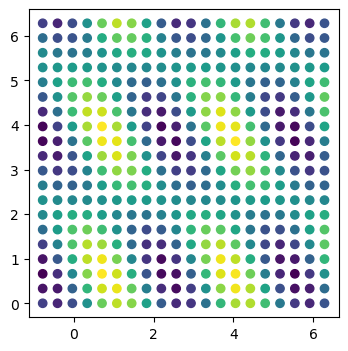

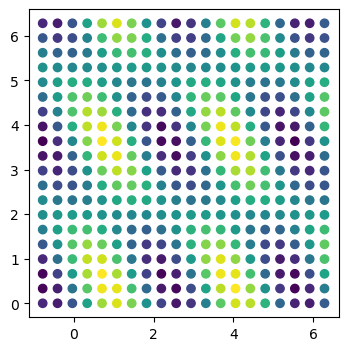

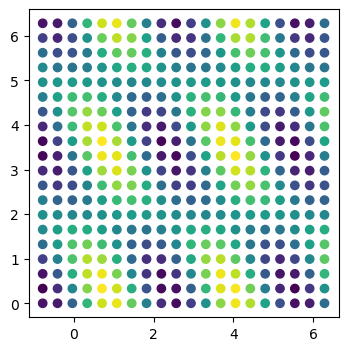

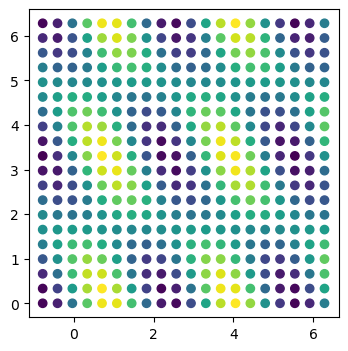

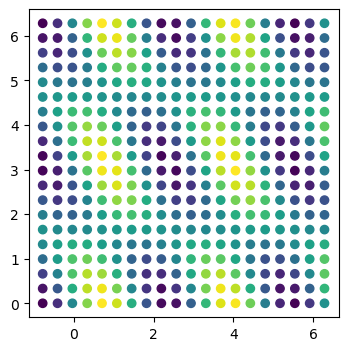

In [349]:
points_in_R400 = []
for f in isoms:
    view_isom_sq(isom_inv = f,image_function =sincos, num_pixels = 20, window_size =2*pi, x_center = -pi/4)
    pixels = get_sq_pixels(num_pixels = 20, window_size=2*pi, x_center = -pi/4)
    point = new_colors(pixels, iso_inv=f, image_function=sincos)
    points_in_R400.append(point)

In [350]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[2.328745077012485,
 2.3303635662095545,
 2.3308668159486134,
 2.3300432763919097,
 2.328239198159193,
 2.3262141952817648,
 2.32482271268871,
 2.3246529955278277,
 2.325776853346838,
 2.3277190186825676,
 2.329659564895509,
 2.3307810086442218,
 2.3306117253716416,
 2.3292228698736954,
 2.32719872293453,
 2.3253924378508497,
 2.3245669588511877,
 2.3250714632363736,
 2.3266925078667313,
 9.74595480535319e-15]

In [351]:
sum(distances)

44.22664096877422

In [352]:
isoms = []
for i in range(20):
    theta = pi/19 * i 
    isom1 = isom(-3*pi/4,-pi,0)
    isom2 = isom(0,0,theta)
    isom3 = isom(3*pi/4,pi,0)
    f = compose_isoms(isom1,isom2,isom3)
    isoms.append(f)

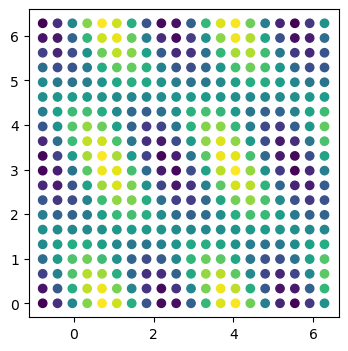

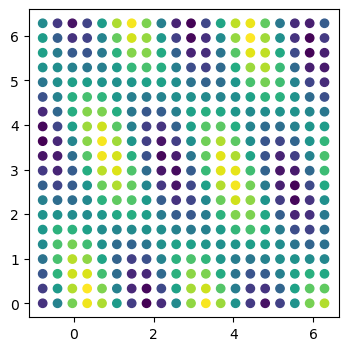

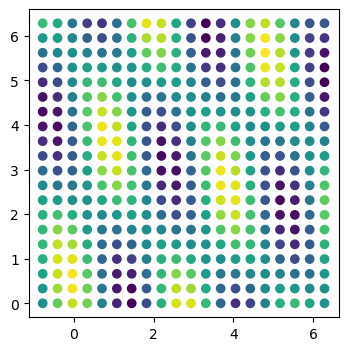

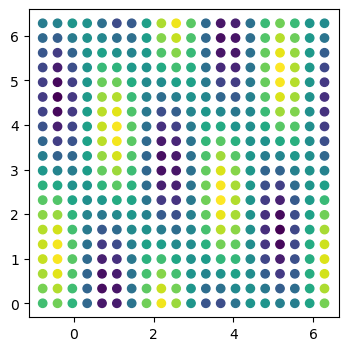

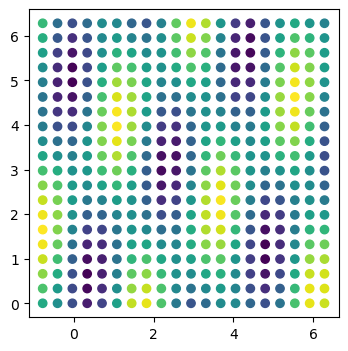

...

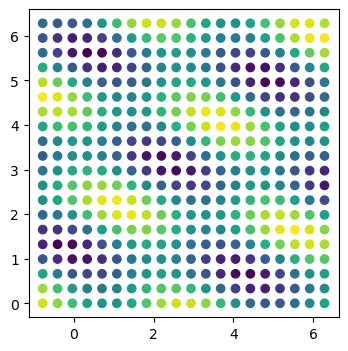

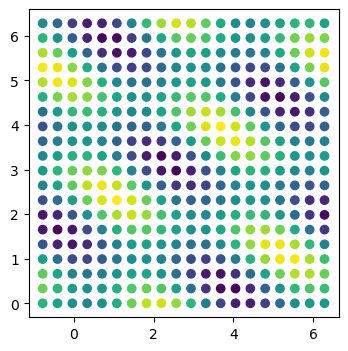

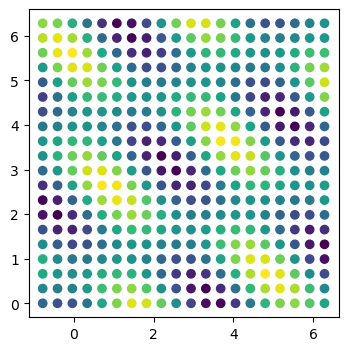

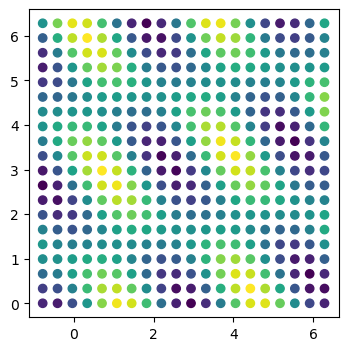

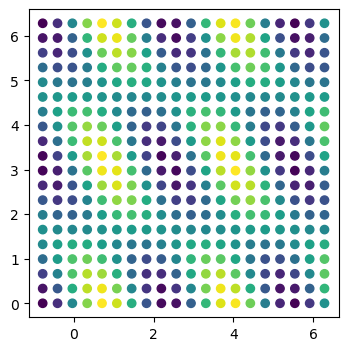

In [353]:
points_in_R400 = []
for f in isoms:
    view_isom_sq(isom_inv = f,image_function =sincos, num_pixels = 20, window_size =2*pi, x_center = -pi/4)
    pixels = get_sq_pixels(num_pixels = 20, window_size=2*pi, x_center = -pi/4)
    point = new_colors(pixels, iso_inv=f, image_function=sincos)
    points_in_R400.append(point)

In [354]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[7.869456191056385,
 7.522239468839014,
 7.450484552960171,
 7.510768027782425,
 7.725196542139728,
 7.7822199913086365,
 7.979994422682659,
 8.189529280206719,
 8.529523780130837,
 8.566623696798127,
 8.786106278651419,
 8.409550954521814,
 8.042514665145045,
 8.265905028446712,
 8.240159615307565,
 8.281337072810302,
 8.481536909260777,
 8.502531924750722,
 8.271797963539758,
 1.2593172859368633e-14]

In [355]:
sum(distances)

154.4074763663388

vertical: 64

horizontal: 44

rotational: 154

# trying with C3

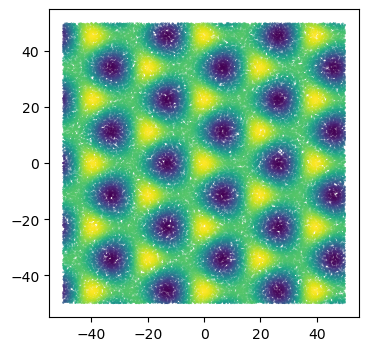

In [401]:
def p3(x,y):
    X = 1/(2 * pi) * (x + y / (3**(1/2)))
    Y = 1/(2 * pi) * 2 * y / (3**(1/2))
    C = cos(X + Y) + cos(X - 2 * Y) + cos(-2 * X + Y)
    S = sin(X + Y) +sin(X - 2*Y) +sin(-2 * X + Y)
    return C + S

graph_continuous(p3, 50,50)

In [405]:
isoms = []
for i in range(20):
    a = 40 * i/19
    f = isom(a,0,0)
    isoms.append(f)

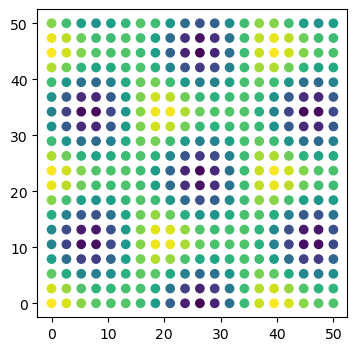

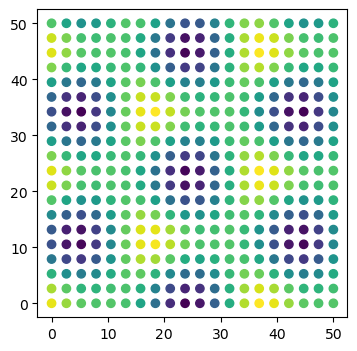

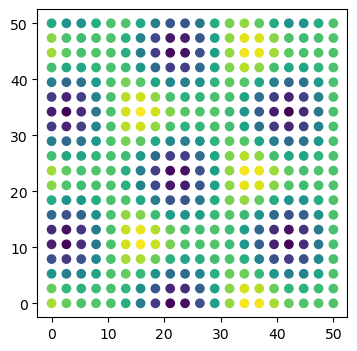

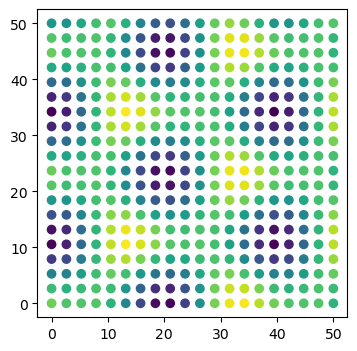

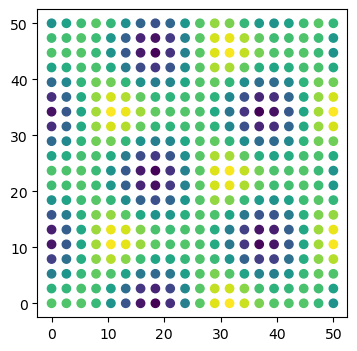

...

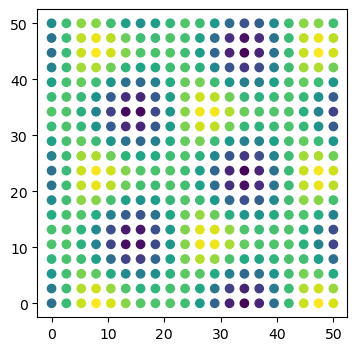

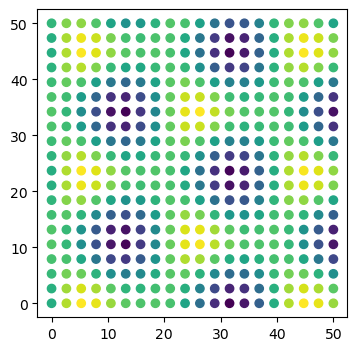

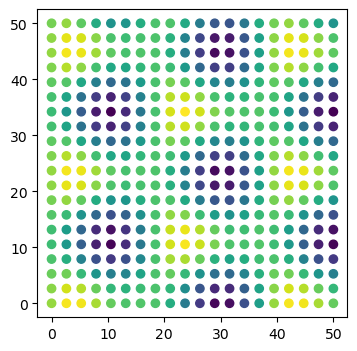

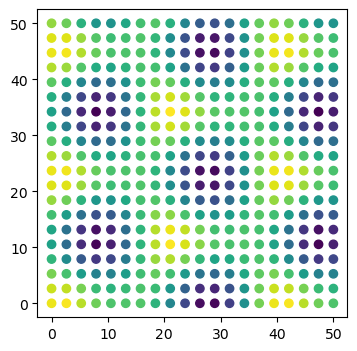

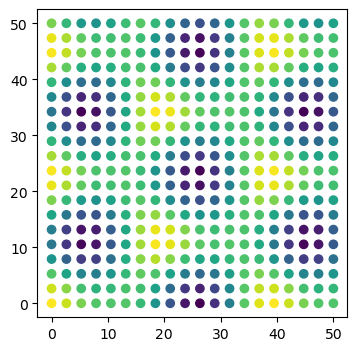

In [406]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function =p3, num_pixels = 20, window_size =50)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=50)
    point = new_colors(pixels, iso_inv=f, image_function=p3)
    points_in_R400.append(point)

In [407]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[16.038098663248615,
 16.157582092152232,
 15.973165243315524,
 15.98148516944543,
 16.383428215177663,
 16.687602419821616,
 16.44925568185144,
 15.943594240850922,
 15.838902274960141,
 16.237255813767437,
 16.561664428726473,
 16.479576672175487,
 16.33751042347332,
 16.547118716158476,
 16.85640290294453,
 16.706551459162796,
 16.084215374640394,
 15.623595684932317,
 15.760128723080962,
 3.9937787805987677]

In [408]:
sum(distances)

312.64091298048453

In [417]:
isoms = []
for i in range(20):
    b = 22.5 * i/19
    f = isom(0,b,0)
    isoms.append(f)

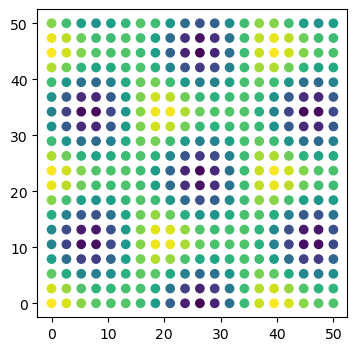

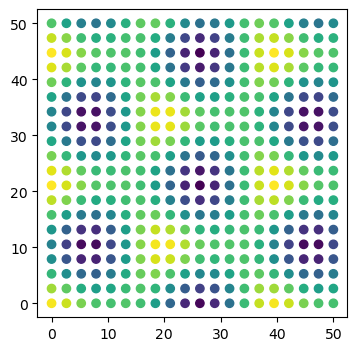

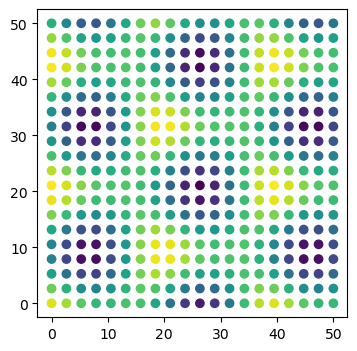

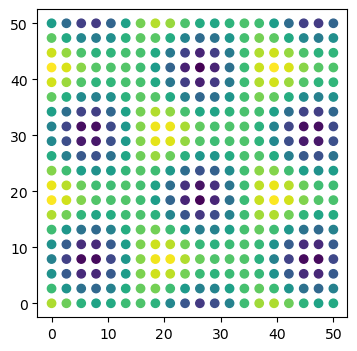

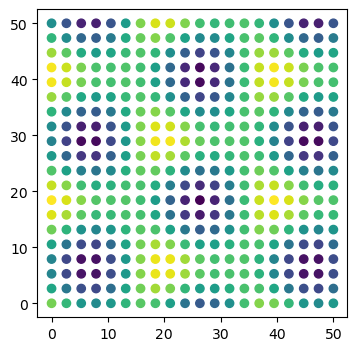

...

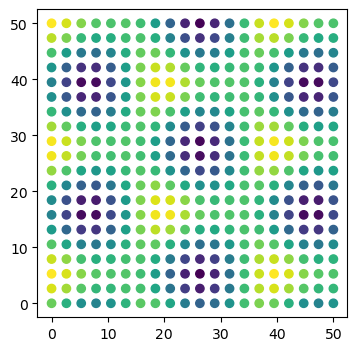

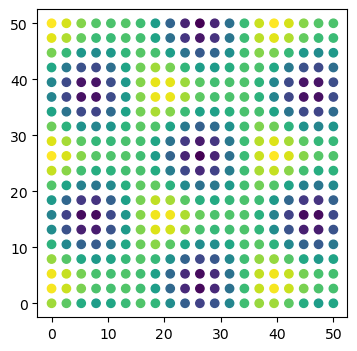

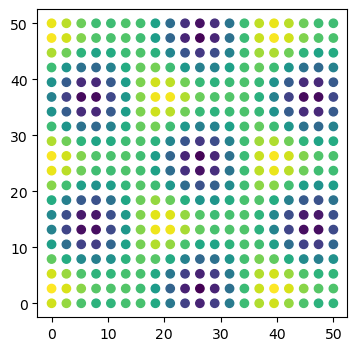

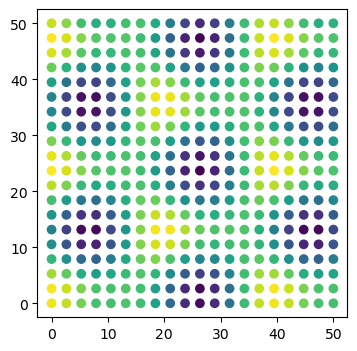

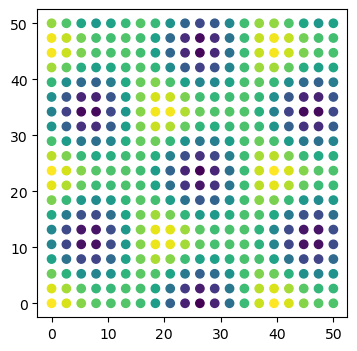

In [418]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function =p3, num_pixels = 20, window_size =50)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=50)
    point = new_colors(pixels, iso_inv=f, image_function=p3)
    points_in_R400.append(point)

In [419]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[9.657723701410946,
 9.863760786155323,
 9.98677586871118,
 9.979625475473876,
 9.845008862442763,
 9.634690479543185,
 9.433309498604322,
 9.326516278162298,
 9.36168117785519,
 9.523051848305796,
 9.74026222231309,
 9.923333065520396,
 10.000363389575103,
 9.942112689652456,
 9.770638868968554,
 9.55285367272071,
 9.378248710856766,
 9.322480812027456,
 9.4104885634686,
 2.36505757193743]

In [420]:
sum(distances)

186.01798354370544

In [421]:
# purple dot
isoms = []
for i in range(20):
    theta = (2*pi/3)/19 * i 
    isom1 = isom(-27,-23.5,0)
    isom2 = isom(0,0,theta)
    isom3 = isom(27,23.5,0)
    f = compose_isoms(isom1,isom2,isom3)
    isoms.append(f)

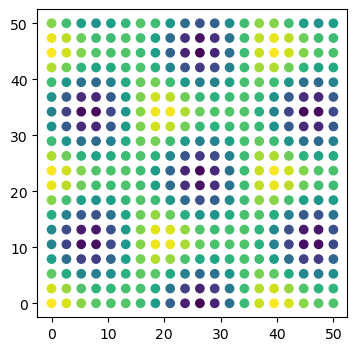

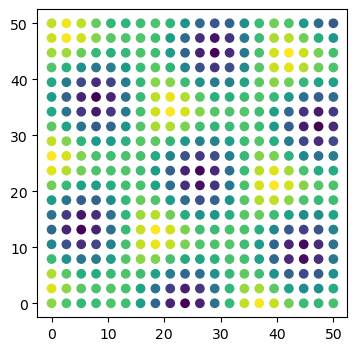

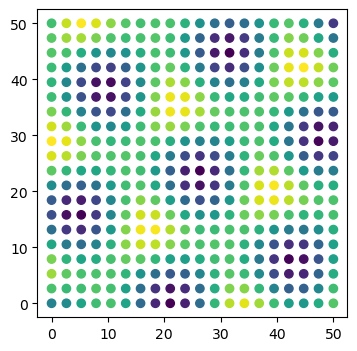

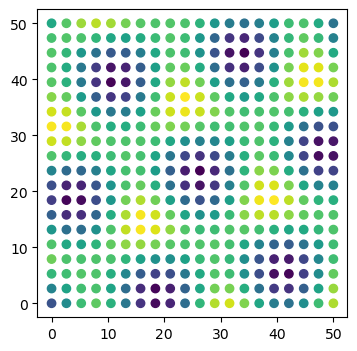

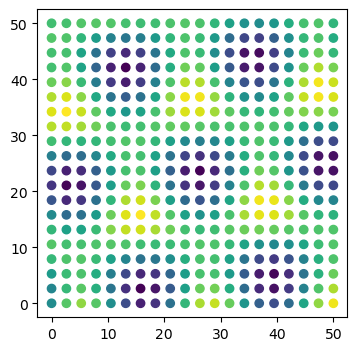

...

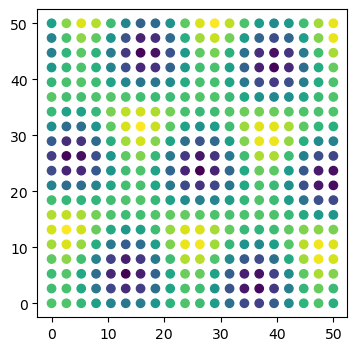

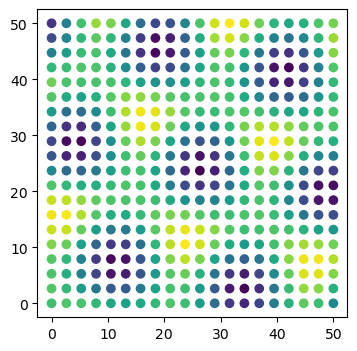

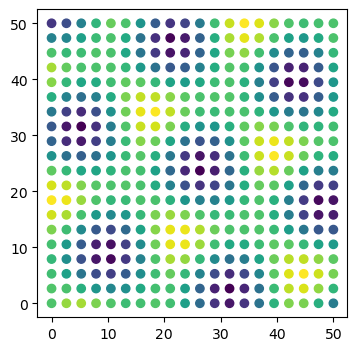

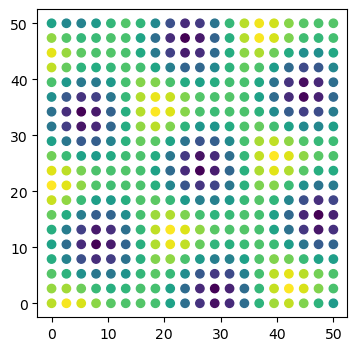

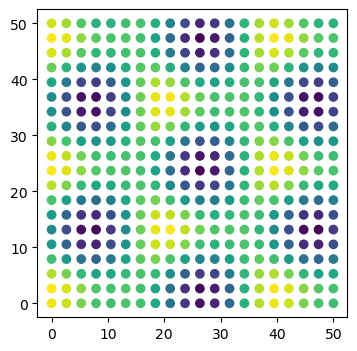

In [422]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function =p3, num_pixels = 20, window_size =50)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=50)
    point = new_colors(pixels, iso_inv=f, image_function=p3)
    points_in_R400.append(point)

In [423]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[18.635016395964925,
 18.538628659238856,
 18.24642814457869,
 18.11522827085495,
 18.15707077124164,
 18.28877517483237,
 18.153046079205343,
 18.13087617733439,
 18.431984446994225,
 18.37926024636246,
 18.358473024977606,
 18.30763881427785,
 18.589193684620838,
 18.677957099892225,
 18.7926356994559,
 18.91664259463233,
 18.624530600665764,
 18.96806945196455,
 18.829733915288312,
 13.452815310410736]

In [424]:
sum(distances)

364.594004562794

In [425]:
# yellow dot
isoms = []
for i in range(20):
    theta = (2*pi/3)/19 * i 
    isom1 = isom(-20,-11,0)
    isom2 = isom(0,0,theta)
    isom3 = isom(20,11,0)
    f = compose_isoms(isom1,isom2,isom3)
    isoms.append(f)

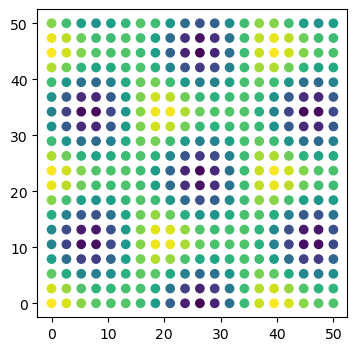

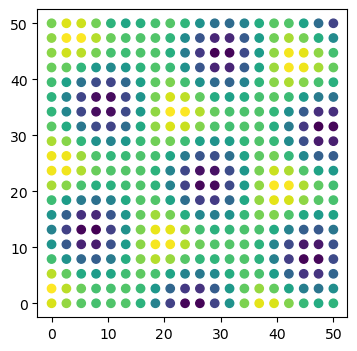

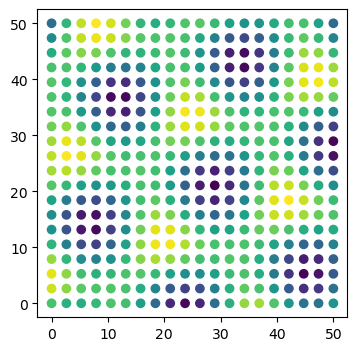

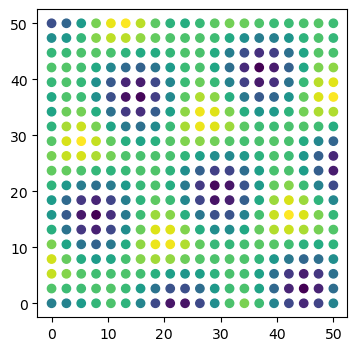

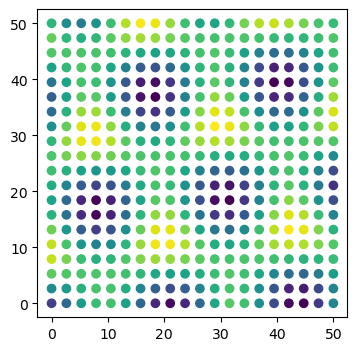

...

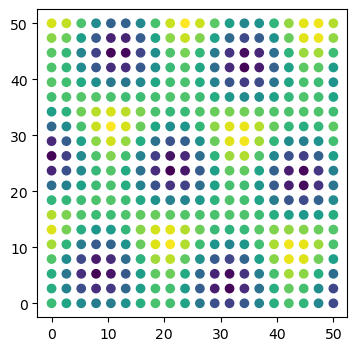

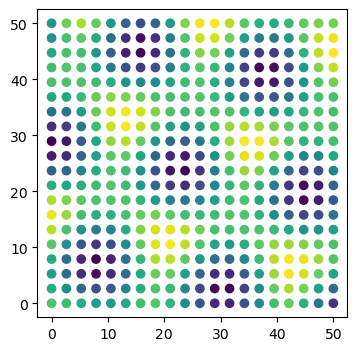

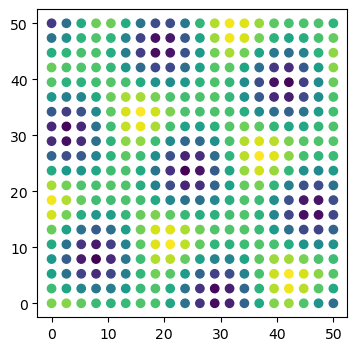

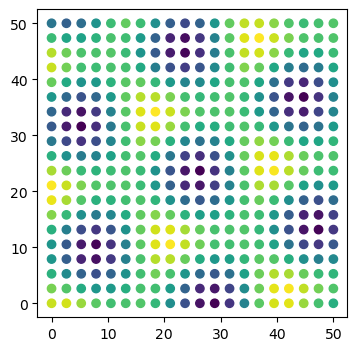

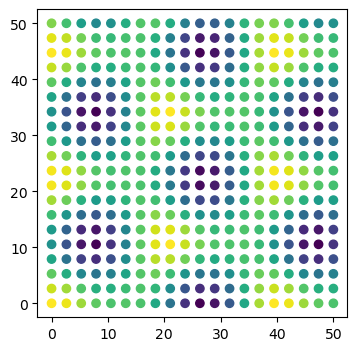

In [426]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function =p3, num_pixels = 20, window_size =50)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=50)
    point = new_colors(pixels, iso_inv=f, image_function=p3)
    points_in_R400.append(point)

In [427]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[21.62983033046019,
 21.588139044861887,
 20.89820483031605,
 20.298908383991293,
 20.221837304053828,
 20.21856543505944,
 20.81456436169341,
 21.616123229045307,
 20.729224169774184,
 20.900198774311438,
 21.253575403955004,
 21.73435699272109,
 21.83054522947761,
 22.815296728948997,
 22.718155149647377,
 21.8334948824351,
 21.85000975938297,
 21.818022393870173,
 21.987174370986153,
 6.293032170691113]

In [428]:
sum(distances)

413.0492589456827

In [429]:
isoms = []
for i in range(20):
    theta = (2*pi/3)/19 * i 
    isom1 = isom(-13,-23,0)
    isom2 = isom(0,0,theta)
    isom3 = isom(13,23,0)
    f = compose_isoms(isom1,isom2,isom3)
    isoms.append(f)

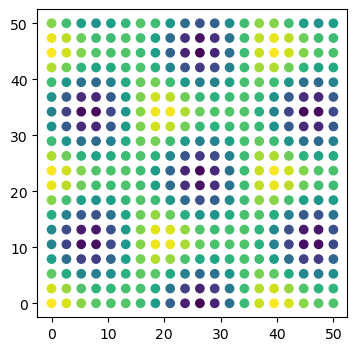

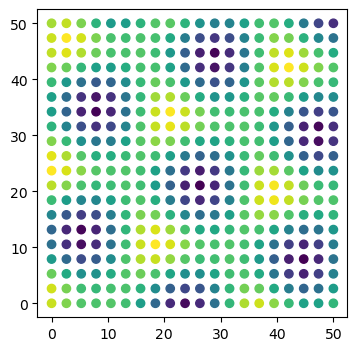

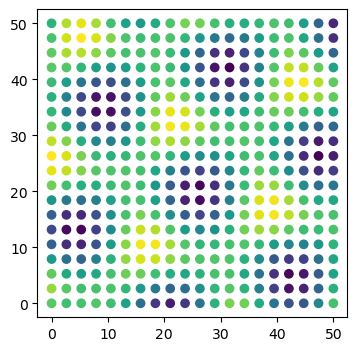

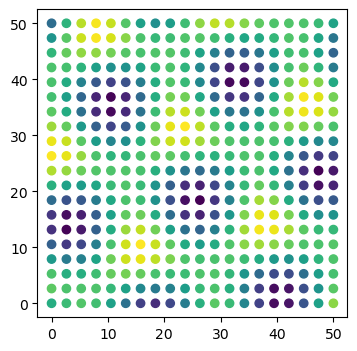

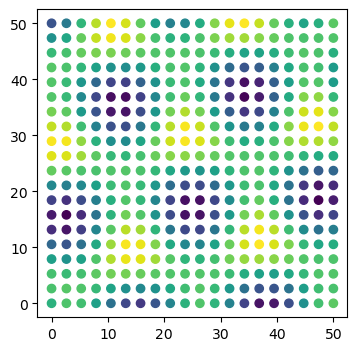

...

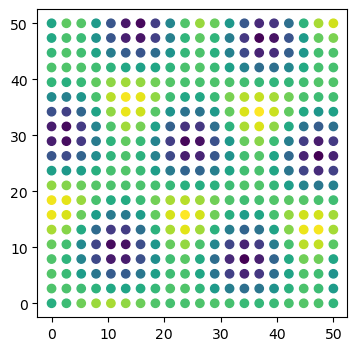

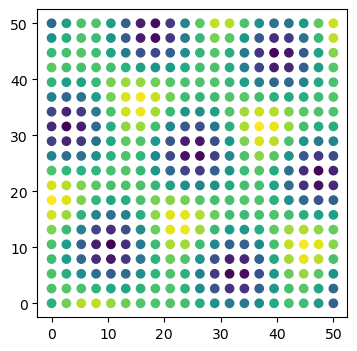

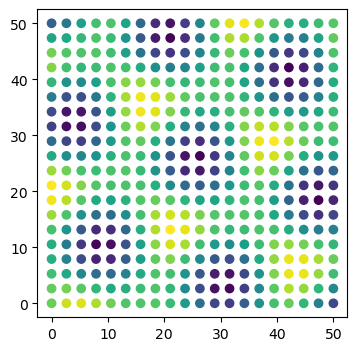

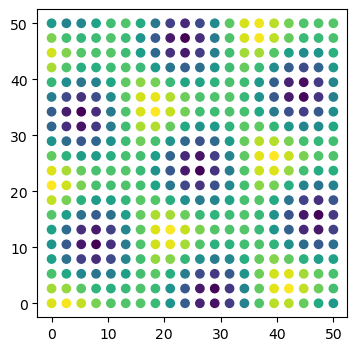

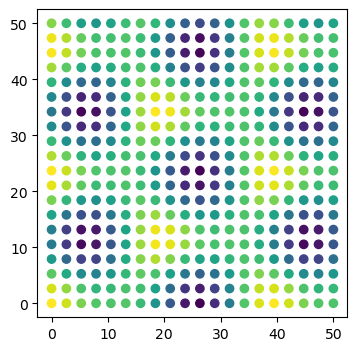

In [430]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function =p3, num_pixels = 20, window_size =50)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=50)
    point = new_colors(pixels, iso_inv=f, image_function=p3)
    points_in_R400.append(point)

In [431]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[21.267472414603013,
 20.691993246170117,
 20.315894907364143,
 19.36313544598506,
 19.494549475661945,
 19.59774628579272,
 19.98399141175417,
 20.574758752900898,
 20.16868482519066,
 20.008696055951386,
 20.240899827783938,
 20.1002109351081,
 19.772332595348445,
 19.558439105416877,
 19.905254233778685,
 20.419403381714815,
 20.69692332626842,
 21.003990987813676,
 20.9407737799224,
 3.4816098852017827]

In [432]:
sum(distances)

387.58676087973123

# and now C4

In [433]:
def checker(x,y): 
    if 0 <= x%2 < 1 and 0 <= y%2 < 1:
        res = 1 
    elif 1 <= x%2 < 2 and 1 <= y%2 < 2:
        res = 1
    else: 
        res = 0
    return res

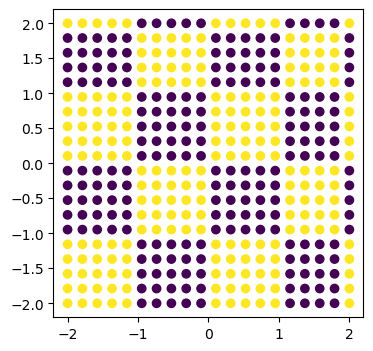

In [434]:
view_window_continuous(image_function = checker, num_pixels=20, window_size=4)

In [435]:
isoms = []
for i in range(20):
    a = 2 * i/19
    f = isom(a,0,0)
    isoms.append(f)

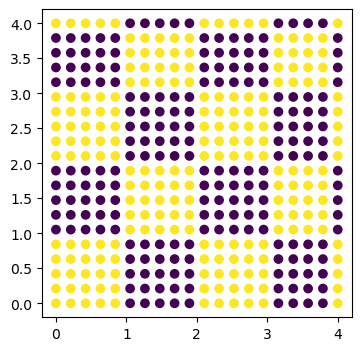

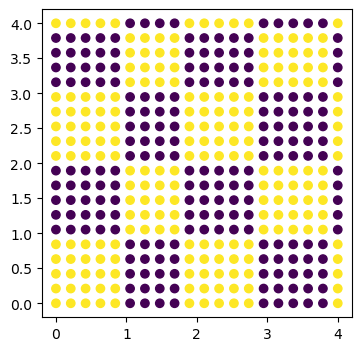

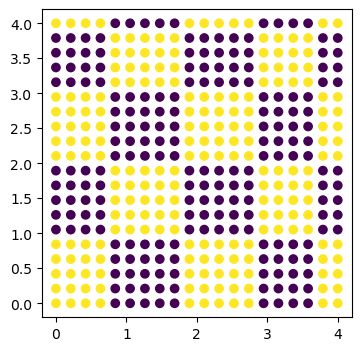

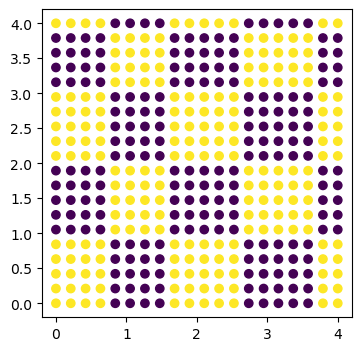

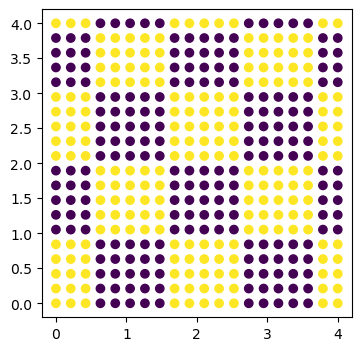

...

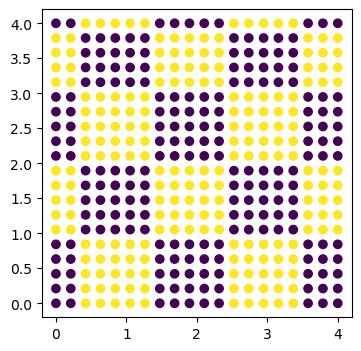

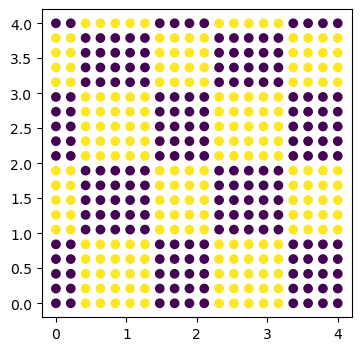

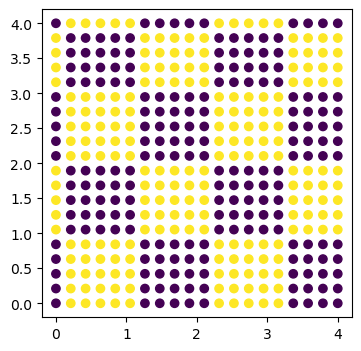

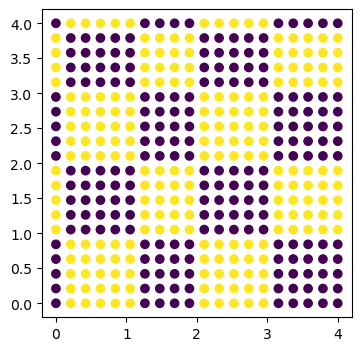

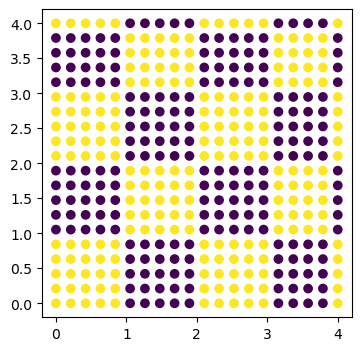

In [438]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function =checker, num_pixels = 20, window_size =4)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=4)
    point = new_colors(pixels, iso_inv=f, image_function=checker)
    points_in_R400.append(point)

In [439]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 4.47213595499958,
 7.745966692414834,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 7.745966692414834,
 6.324555320336759,
 4.47213595499958,
 7.745966692414834,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 7.745966692414834,
 0.0]

In [441]:
sum(distances)

122.14735784403634

In [442]:
isoms = []
for i in range(20):
    b = 2 * i/19
    f = isom(0,b,0)
    isoms.append(f)

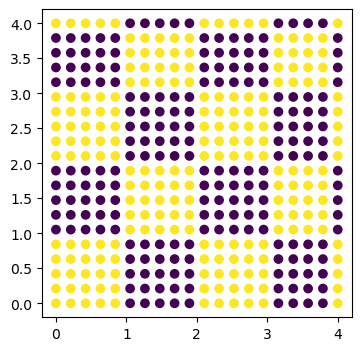

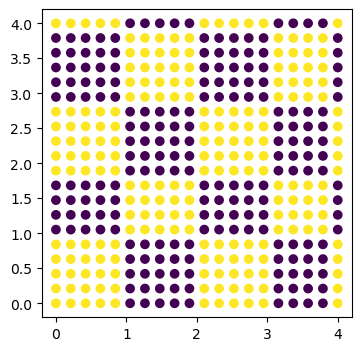

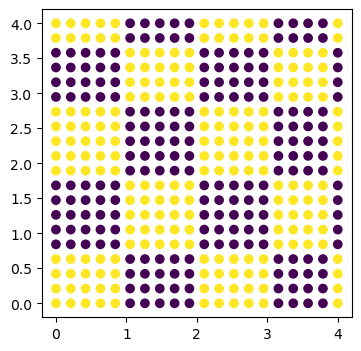

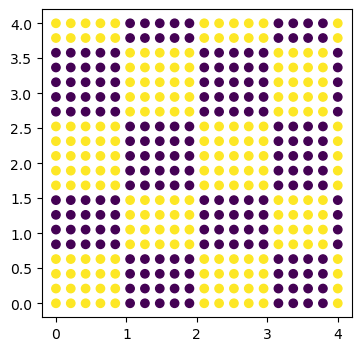

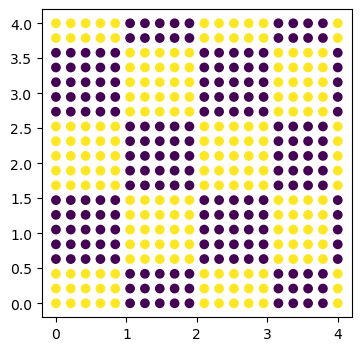

...

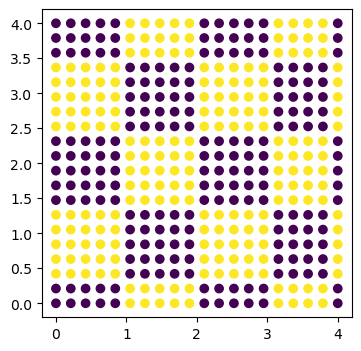

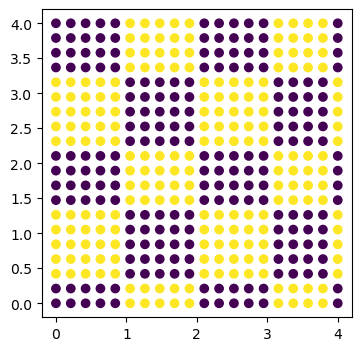

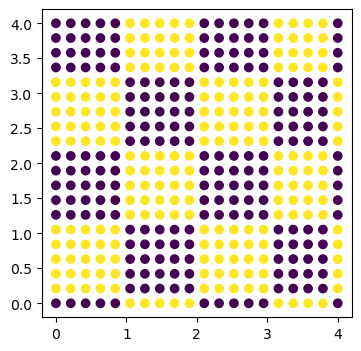

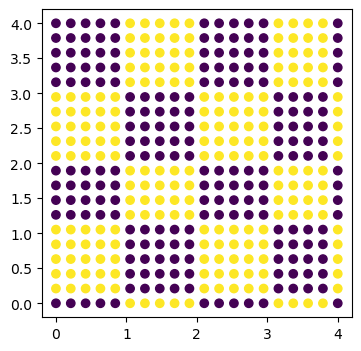

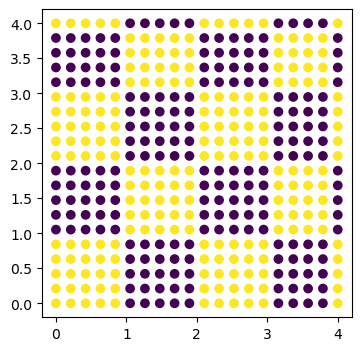

In [443]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function =checker, num_pixels = 20, window_size =4)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=4)
    point = new_colors(pixels, iso_inv=f, image_function=checker)
    points_in_R400.append(point)

In [444]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 4.47213595499958,
 7.745966692414834,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 7.745966692414834,
 6.324555320336759,
 4.47213595499958,
 7.745966692414834,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 6.324555320336759,
 7.745966692414834,
 0.0]

In [445]:
sum(distances)

122.14735784403634

In [448]:
isoms = []
for i in range(20):
    theta = (pi/2)/19 * i 
    isom1 = isom(-2.5,-1.5,0)
    isom2 = isom(0,0,theta)
    isom3 = isom(2.5,1.5,0)
    f = compose_isoms(isom1,isom2,isom3)
    isoms.append(f)

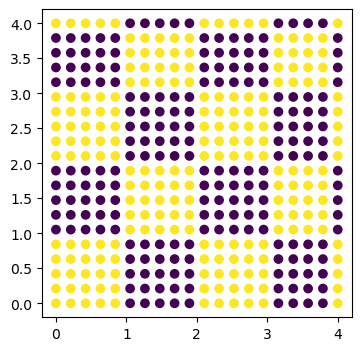

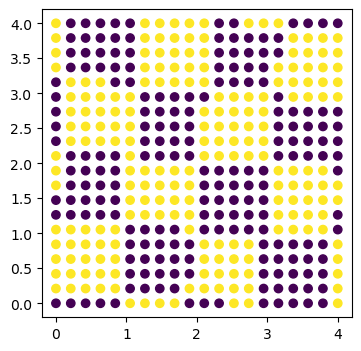

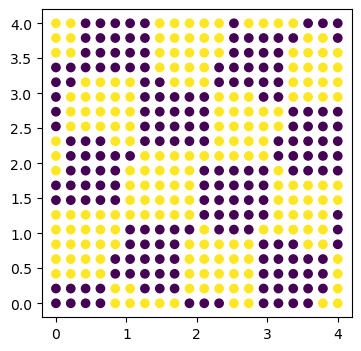

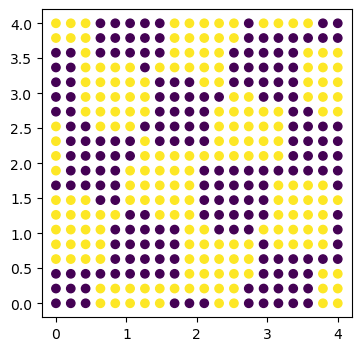

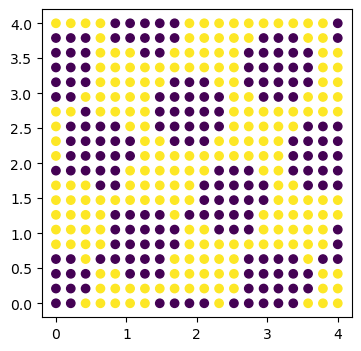

...

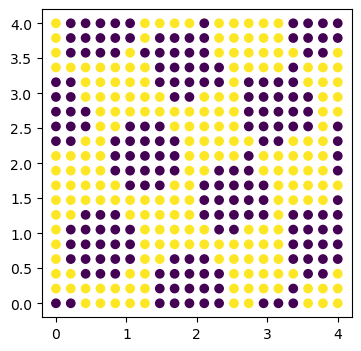

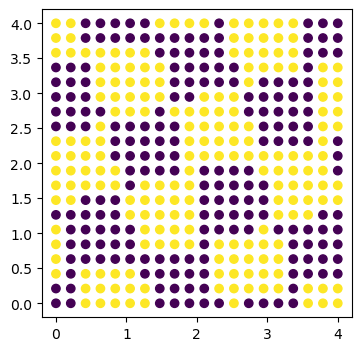

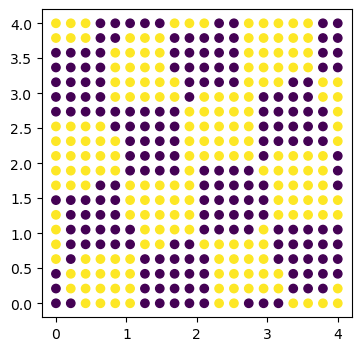

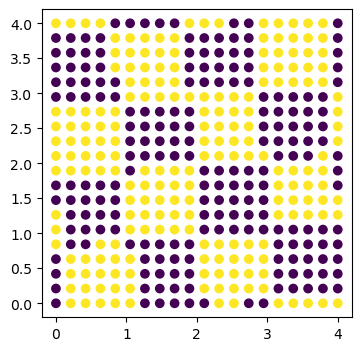

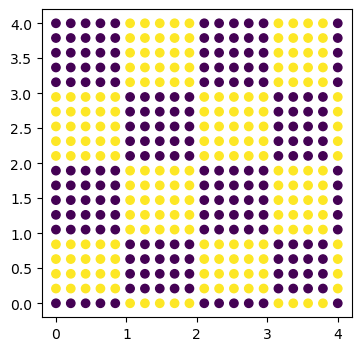

In [449]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function =checker, num_pixels = 20, window_size =4)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=4)
    point = new_colors(pixels, iso_inv=f, image_function=checker)
    points_in_R400.append(point)

In [450]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[9.1104335791443,
 7.937253933193772,
 8.366600265340756,
 8.366600265340756,
 7.937253933193772,
 8.12403840463596,
 8.18535277187245,
 8.0,
 7.681145747868608,
 8.366600265340756,
 7.681145747868608,
 8.0,
 8.18535277187245,
 8.12403840463596,
 7.937253933193772,
 8.366600265340756,
 8.366600265340756,
 7.937253933193772,
 8.660254037844387,
 6.324555320336759]

In [451]:
sum(distances)

161.6583338455584

horizontal: 122
    
vertical: 122
    
rotational: 161

# finally C6

In [452]:
def p6(x,y):
    X = 1/(2 * pi) * (x + y / (3**(1/2)))
    Y = 1/(2 * pi) * 2 * y / (3**(1/2))
    C = cos(X + Y) + cos(X - 2 * Y) + cos(-2 * X + Y)
    S = sin(X + Y) +sin(X - 2*Y) +sin(-2 * X + Y)
    return C 

In [460]:
isoms = []
for i in range(20):
    a = 40 * i/19
    f = isom(a,0,0)
    isoms.append(f)

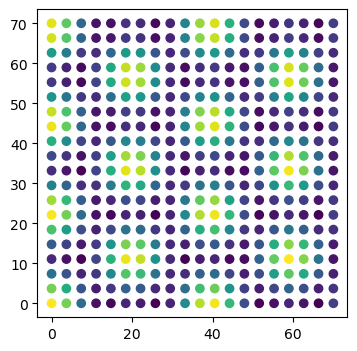

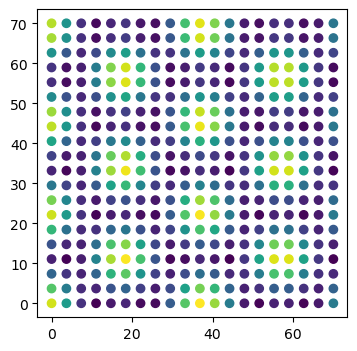

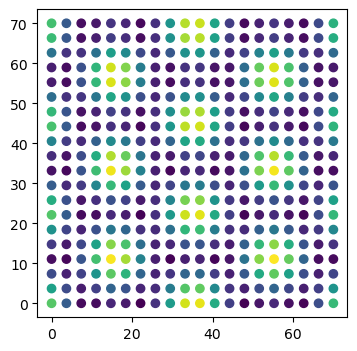

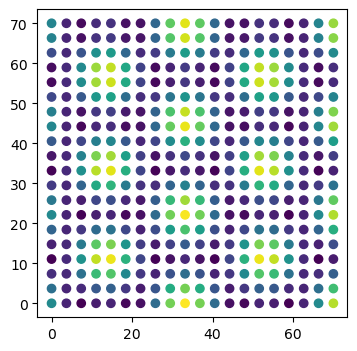

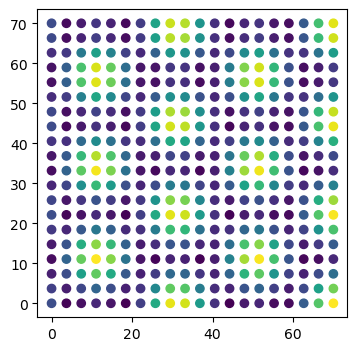

...

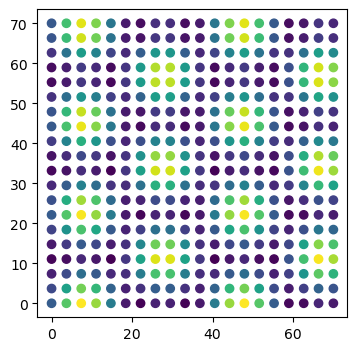

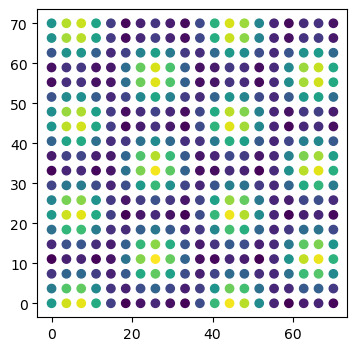

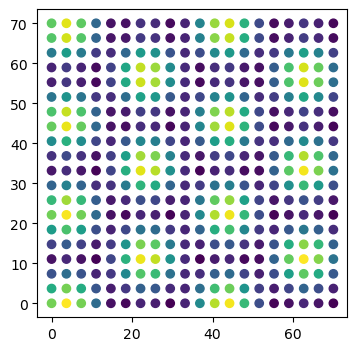

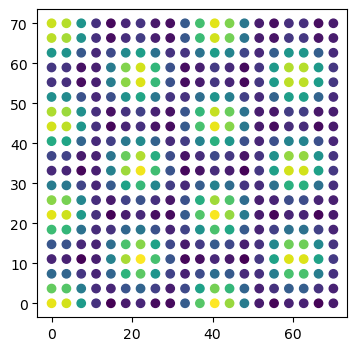

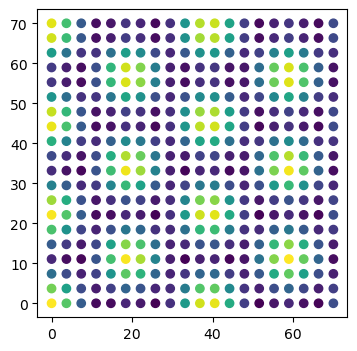

In [461]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function = p6, num_pixels = 20, window_size =70)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=70)
    point = new_colors(pixels, iso_inv=f, image_function=p6)
    points_in_R400.append(point)

In [462]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[11.461446510340656,
 11.794071235137327,
 11.846407237331757,
 11.549947676976451,
 11.291941486717404,
 11.374869559130213,
 11.584457565397715,
 11.575764507663104,
 11.410316878185975,
 11.437773485361554,
 11.71501430538517,
 11.88502954315029,
 11.71699268070425,
 11.439055573335496,
 11.40950012073142,
 11.574828786225217,
 11.585351373748093,
 11.37633715117717,
 11.291301869489782,
 2.84921759383435]

In [463]:
sum(distances)

222.1696251400234

In [476]:
isoms = []
for i in range(20):
    b = 23 * i/19
    f = isom(0,b,0)
    isoms.append(f)

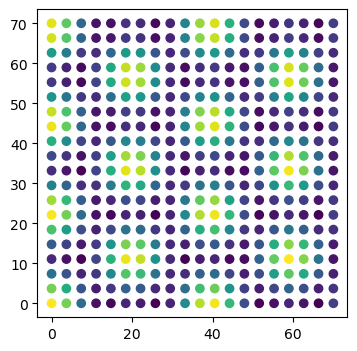

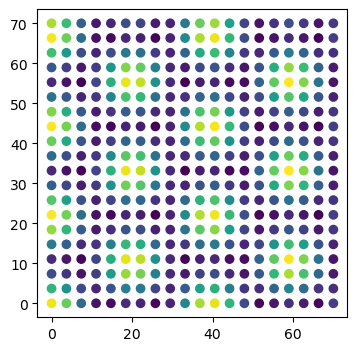

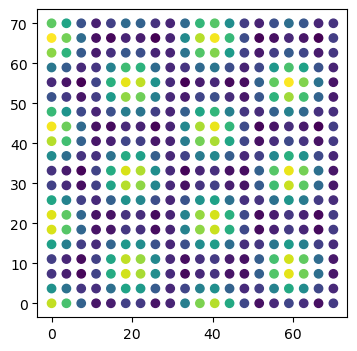

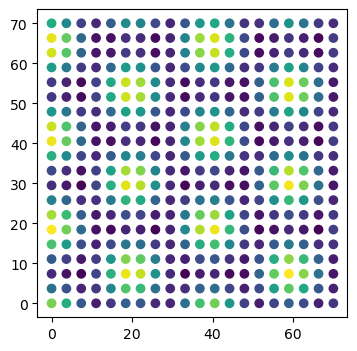

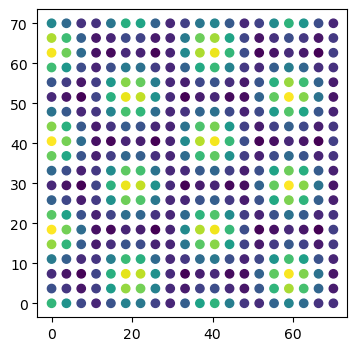

...

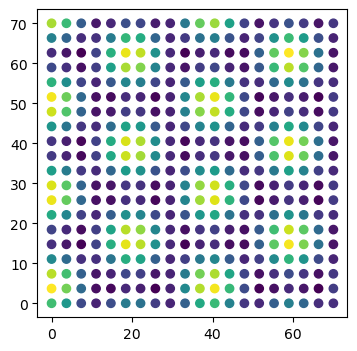

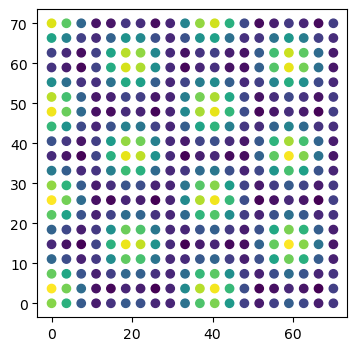

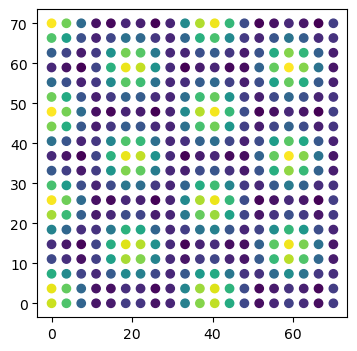

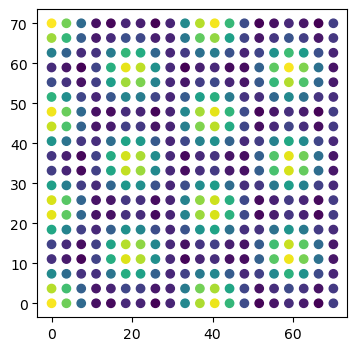

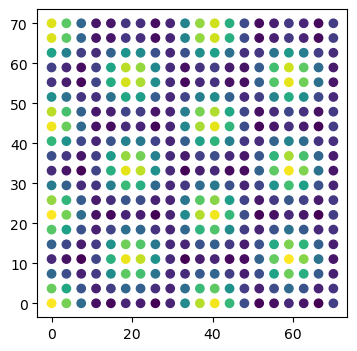

In [477]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function = p6, num_pixels = 20, window_size =70)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=70)
    point = new_colors(pixels, iso_inv=f, image_function=p6)
    points_in_R400.append(point)

In [478]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[6.471834668909671,
 6.5869360758287865,
 6.7100755723803145,
 6.789267489381605,
 6.792354983018437,
 6.7181038173670995,
 6.596600702415932,
 6.478965192597944,
 6.4170502432467496,
 6.439131487430857,
 6.535044731669205,
 6.661659837082971,
 6.764472307625139,
 6.801144795952978,
 6.756972740258334,
 6.649693059523185,
 6.52364810163886,
 6.433344660507422,
 6.419528300857958,
 1.106734454853366]

In [479]:
sum(distances)

126.65256322254682

In [484]:
isoms = []
for i in range(20):
    theta = (pi/3)/19 * i 
    isom1 = isom(-39,-23,0)
    isom2 = isom(0,0,theta)
    isom3 = isom(39,23,0)
    f = compose_isoms(isom1,isom2,isom3)
    isoms.append(f)

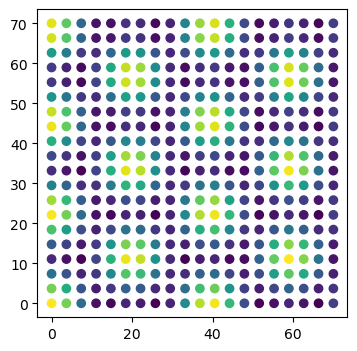

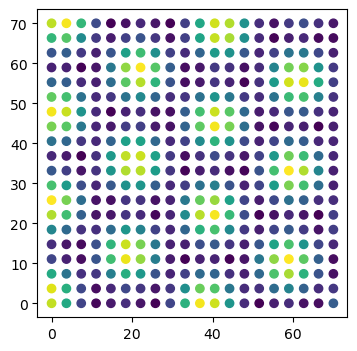

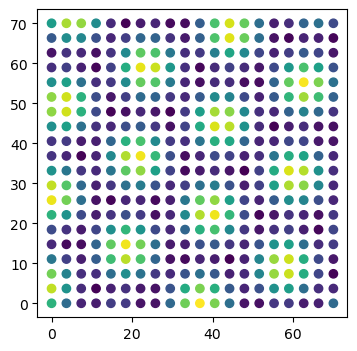

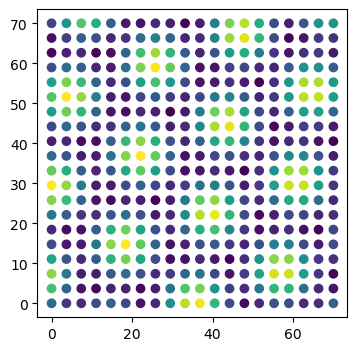

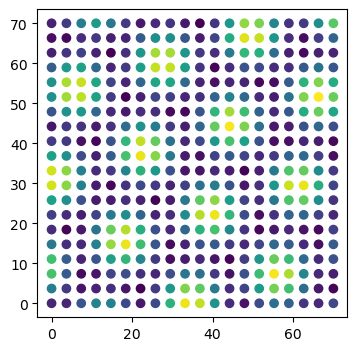

...

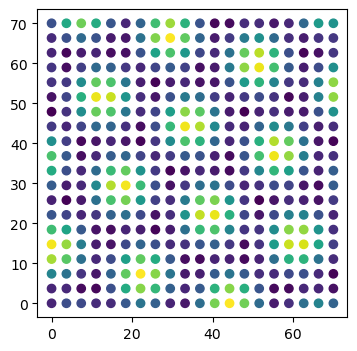

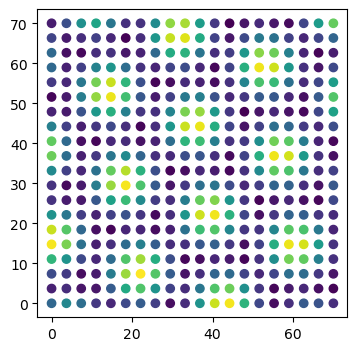

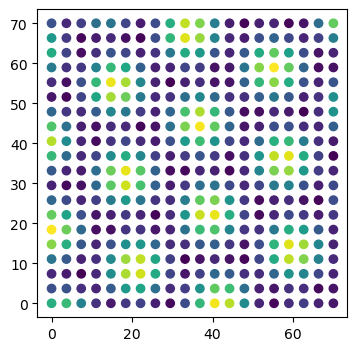

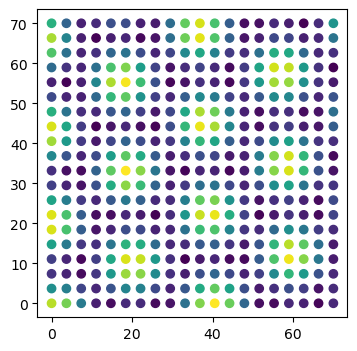

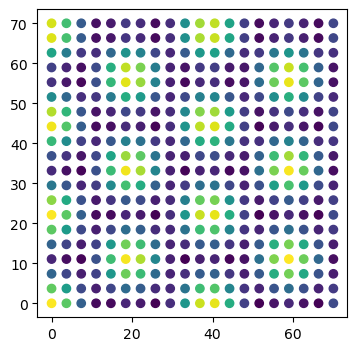

In [485]:
points_in_R400 = []
for f in isoms:
    view_isom2(isom_inv = f,image_function = p6, num_pixels = 20, window_size =70)
    pixels = get_unitsq_pixels(num_pixels = 20, window_size=70)
    point = new_colors(pixels, iso_inv=f, image_function=p6)
    points_in_R400.append(point)

In [486]:
distances = []
for i in range(len(points_in_R400)-1):
    distances.append(dist(points_in_R400[i],points_in_R400[i+1]))
distances.append(dist(points_in_R400[0],points_in_R400[len(points_in_R400)-1]))
distances

[9.530919210910778,
 9.77815397201109,
 9.93495045914755,
 9.788959317954552,
 9.668180352877496,
 9.661765885909299,
 9.619452732163907,
 9.589949431356953,
 9.645253010661886,
 9.796511634359938,
 9.920155384890423,
 9.831104825324966,
 9.690286716847499,
 9.744311715319622,
 9.789715778549276,
 9.652757966390835,
 9.5942484728317,
 9.66596270780666,
 9.574701010334536,
 2.826265914447842]

In [487]:
sum(distances)

187.3036065000968

horizontal: 222
    
vertical: 126
    
rotational: 187